In [1]:
%pip install sympy

Process pip requirements ...



In [1]:
import sympy as smp

In [2]:
from scipy.integrate import odeint
import numpy as np

In [3]:
t,g,m1,m2,m3,L1,L2,L3 = smp.symbols('t g m1 m2 m3 L1 L2 L3')
theta1 = smp.Function('theta1')
theta2 = smp.Function('theta2')
theta3 = smp.Function('theta3')

In [4]:
theta1_d = smp.diff(theta1,t)
theta2_d = smp.diff(theta2,t)
theta3_d = smp.diff(theta3,t)


In [5]:
theta1_dd = smp.diff(theta1_d,t)
theta2_dd = smp.diff(theta2_d,t)
theta3_dd = smp.diff(theta3_d,t)

In [6]:
theta1 = theta1(t)
theta2 = theta2(t)
theta3 = theta3(t)

In [7]:
x1 = L1*smp.sin(theta1)
x2 = x1+L2*smp.sin(theta2)
x3 = x2+L3*smp.sin(theta3)

y1 = -L1*smp.cos(theta1)
y2 = y1-L2*smp.cos(theta2)
y3 = y2-L3*smp.cos(theta3)

In [8]:
T1 = smp.Rational(1,2) * m1 * (smp.diff(x1,t)**2+smp.diff(y1,t)**2).simplify()
T2 = smp.Rational(1,2) * m2 * (smp.diff(x2,t)**2+smp.diff(y2,t)**2).simplify()
T3 = smp.Rational(1,2) * m3 * (smp.diff(x3,t)**2+smp.diff(y3,t)**2).simplify()
T = T1+T2+T3
V1 = m1*g*y1
V2 = m1*g*y2
V3 = m1*g*y3
V = V1+V2+V3



In [9]:
L = T-V

In [10]:
theta1_dd

0

In [11]:
E1 = smp.diff(L,theta1) - smp.diff(smp.diff(L,theta1_d),t)
E2 = smp.diff(L,theta2) - smp.diff(smp.diff(L,theta2_d),t)
E3 = smp.diff(L,theta3) - smp.diff(smp.diff(L,theta3_d),t)

ValueError: First variable cannot be a number: 1

In [24]:
sols = smp.solve([E1,E2,E3], (theta1_dd,theta2_dd,theta3_dd))

In [26]:
theta1_dd_f = smp.lambdify((theta1,theta2,theta3,theta1_d,theta2_d,theta3_d,m1,m2,m3,L1,L2,L3,g),sols[theta1_dd])
theta2_dd_f = smp.lambdify((theta1,theta2,theta3,theta1_d,theta2_d,theta3_d,m1,m2,m3,L1,L2,L3,g),sols[theta2_dd])
theta3_dd_f = smp.lambdify((theta1,theta2,theta3,theta1_d,theta2_d,theta3_d,m1,m2,m3,L1,L2,L3,g),sols[theta3_dd])

In [28]:
#let S(t,theta1,theta2,theta3,theta1_d,theta2_d,theta3_d,m1,m2,m3,L1,L2,L3)
def dSdt(S,t,m1,m2,m3,L1,L2,L3,g):
    the1,the2,the3,the1_d,the2_d,the3_d= S
    return [
    the1_d,
    the2_d,
    the3_d, 
    theta1_dd_f(the1,the2,the3,the1_d,the2_d,the3_d,m1,m2,m3,L1,L2,L3,g),
    theta2_dd_f(the1,the2,the3,the1_d,the2_d,the3_d,m1,m2,m3,L1,L2,L3,g),
    theta3_dd_f(the1,the2,the3,the1_d,the2_d,the3_d,m1,m2,m3,L1,L2,L3,g)
    ]

In [ ]:
t = np.linspace(0,30,500)
ep=1e-7
sols = []
for i in range(50):
    y0 = [np.pi/2+ep*i,np.pi/2+ep*i,np.pi/2+ep*i,3,2,1]
    params = (10,1,1,1.5,.5,1,9.8)
    solution = odeint(dSdt,y0,t,args=params)
    sols.append(solution)

In [74]:
solution

array([[ 1.57079633e+00,  7.85398163e-01,  0.00000000e+00,
         3.00000000e+00,  2.00000000e+00,  1.00000000e+00],
       [ 1.73068187e+00,  6.35505911e-01,  1.76144168e-01,
         2.27041053e+00, -7.15747204e+00,  4.96883965e+00],
       [ 1.82933170e+00,  3.72995591e-02,  5.28089122e-01,
         9.63579965e-01, -9.93358515e+00,  4.68280678e+00],
       ...,
       [ 1.53130092e-02,  4.85176258e+01,  1.14528756e+01,
         3.90056663e+00,  2.43280103e+01,  6.63307127e+00],
       [ 1.64252387e-01,  5.04185621e+01,  1.18373707e+01,
         1.41984328e+00,  2.56263568e+01,  1.76042702e+01],
       [ 2.67924709e-01,  5.06587435e+01,  1.35375465e+01,
         2.18989756e+00, -3.91055413e+00,  3.00650856e+01]],
      shape=(500, 6))

In [75]:
thetas = solution[:,:3]

In [33]:
%pip install matplotlib

Process pip requirements ...

Requirement matplotlib already handled by conda/micromamba/mamba.


In [34]:
import matplotlib.pyplot as plt

Matplotlib is building the font cache; this may take a moment.


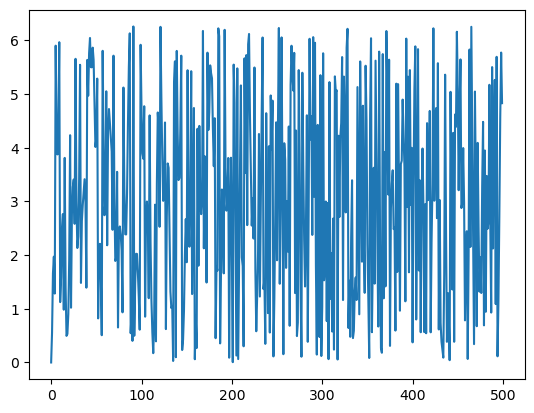

In [76]:
plt.plot(thetas[:,2]%2*(np.pi))

In [77]:
np.save("solution2.npy",solution)

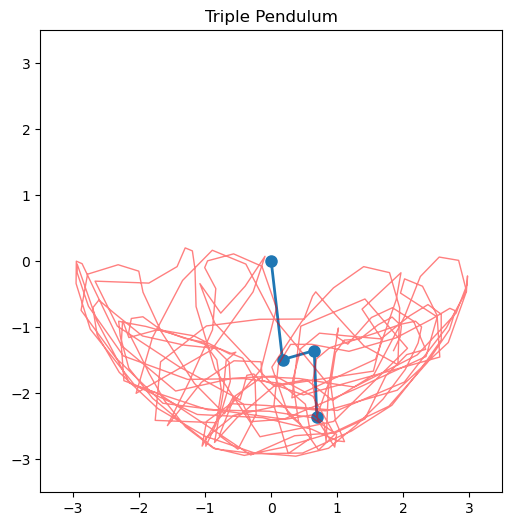

In [79]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import numpy as np
import matplotlib.pyplot as plt

# --- Example data ---
L1 = 1.5
L2 = .5
L3 = 1
# N = 300
# t = np.linspace(0, 10, N)
# theta1 = 0.8 * np.sin(t)
# theta2 = 0.6 * np.sin(2*t + 0.3)
# theta3 = 0.4 * np.sin(3*t + 0.9)
sol = np.load("solution2.npy")
theta1,theta2,theta3 = sol[:,0], sol[:,1], sol[:,2]

x1 = L1 * np.sin(theta1)
y1 = -L1 * np.cos(theta1)
x2 = x1 + L2 * np.sin(theta2)
y2 = y1 - L2 * np.cos(theta2)
x3 = x2 + L3 * np.sin(theta3)
y3 = y2 - L3 * np.cos(theta3)

fig, ax = plt.subplots(figsize=(6,6))
ax.set_xlim(-3.5, 3.5)
ax.set_ylim(-3.5, 3.5)
ax.set_aspect('equal')
ax.set_title("Triple Pendulum")

(line,) = ax.plot([], [], 'o-', lw=2, markersize=8)
(trace,) = ax.plot([], [], 'r-', lw=1, alpha=0.5)
trace_x, trace_y = [], []

def init():
    line.set_data([], [])
    trace.set_data([], [])
    return line, trace

def update(i):
    x = [0, x1[i], x2[i], x3[i]]
    y = [0, y1[i], y2[i], y3[i]]
    line.set_data(x, y)
    trace_x.append(x3[i])
    trace_y.append(y3[i])
    trace.set_data(trace_x, trace_y)
    return line, trace

ani = FuncAnimation(fig, update, frames=N, init_func=init, blit=True)

# 🔑 Display animation as HTML inside JupyterLite
HTML(ani.to_jshtml())


In [ ]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import numpy as np
import matplotlib.pyplot as plt

# --- Example: multiple solutions ---
# sols is a list or array of shape (num_solutions, T, 6)
# Example loading:
# sols = [np.load("solution1.npy"), np.load("solution2.npy"), np.load("solution3.npy")]
# For demonstration, let's say:
# sols = np.array([sol1, sol2, sol3])  # shape: (num_solutions, T, 6)

# --- Replace this with your actual array of solutions ---
sols = np.load("solutions_array.npy", allow_pickle=True)  # shape: (num_solutions, T, 6)
num_sols = len(sols)
T = sols[0].shape[0]

L1, L2, L3 = 1.5, 0.5, 1

# Precompute positions for all solutions
all_positions = []
for sol in sols:
    theta1, theta2, theta3 = sol[:,0], sol[:,1], sol[:,2]
    x1 = L1 * np.sin(theta1)
    y1 = -L1 * np.cos(theta1)
    x2 = x1 + L2 * np.sin(theta2)
    y2 = y1 - L2 * np.cos(theta2)
    x3 = x2 + L3 * np.sin(theta3)
    y3 = y2 - L3 * np.cos(theta3)
    all_positions.append((x1, y1, x2, y2, x3, y3))

# --- Setup plot ---
fig, ax = plt.subplots(figsize=(6,6))
ax.set_xlim(-3.5, 3.5)
ax.set_ylim(-3.5, 3.5)
ax.set_aspect('equal')
ax.set_title("Multiple Triple Pendulums")

colors = plt.cm.jet(np.linspace(0,1,num_sols))

lines = []
traces = []
trace_xs = []
trace_ys = []
for c in colors:
    line, = ax.plot([], [], 'o-', lw=2, markersize=6, color=c)
    trace, = ax.plot([], [], '-', lw=1, alpha=0.5, color=c)
    lines.append(line)
    traces.append(trace)
    trace_xs.append([])
    trace_ys.append([])

# --- Init & update functions ---
def init():
    for line, trace in zip(lines, traces):
        line.set_data([], [])
        trace.set_data([], [])
    return lines + traces

def update(i):
    for idx, (line, trace) in enumerate(zip(lines, traces)):
        x1, y1, x2, y2, x3, y3 = all_positions[idx]
        x = [0, x1[i], x2[i], x3[i]]
        y = [0, y1[i], y2[i], y3[i]]
        line.set_data(x, y)
        trace_xs[idx].append(x3[i])
        trace_ys[idx].append(y3[i])
        trace.set_data(trace_xs[idx], trace_ys[idx])
    return lines + traces

ani = FuncAnimation(fig, update, frames=T, init_func=init, blit=True)

HTML(ani.to_jshtml())
